## Project 4

### Goal 1: Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.

In [2]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import numpy as np
import glob

import matplotlib.gridspec as gs
%matplotlib inline


I have 20 images for the camera. We have done this exercise with 1 image, but I guess with 20 images it is the same but it will improve the calibration quality.

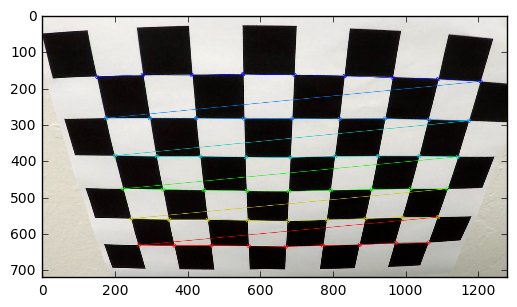

In [3]:
# Load image
n = 2
sample_img = mpimg.imread('camera_cal/calibration{}.jpg'.format(n))

# Convert to gray
gray = cv2.cvtColor(sample_img, cv2.COLOR_RGB2GRAY)

# Find corners
nx = 9
ny = 6
ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

if ret:
    # Draw corners
    cv2.drawChessboardCorners(sample_img, (nx, ny), corners, ret)

    # show image
    plt.imshow(sample_img)

For some images, the algorithm is not finding the corners. That seems to happen with zoomed in pictures where not all corners available, and it seems logic it will not find, as not all corners are available.

I can check if the corners have been found or not for a particular image by checking if ret is True

In [4]:
## use the corners to calibrate the camera
def calibrate_camera():

    # prepare object points, like (0,0,0), (1,0,0)...(6,5,0)
    # further study these two lines
    objp = np.zeros((nx*ny,3), np.float32)
    objp[:, :2] = np.mgrid[:nx, :ny].T.reshape(-1,2)

    # Arrays to store object points and image points
    objpoints = []
    imgpoints = []

    # List of calibration images using glob
    images = glob.glob('camera_cal/calibration*.jpg')

    for idx, fname in enumerate(images):
        # load image and convert to single channel
        img = mpimg.imread(fname)
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

        # find chessboard corners
        ret, corners= cv2.findChessboardCorners(gray, (nx, ny), None)

        # if found, add object points and image points
        if ret:
            objpoints.append(objp)
            imgpoints.append(corners)
            
    # calibrate the camera
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    return ret, mtx, dist, rvecs, tvecs

In [5]:
ret, mtx, dist, rvecs, tvecs = calibrate_camera()

In [6]:
def compare_images(img1, img2, cmap=None):
    # set figure layout 
    f, (ax1, ax2) = plt.subplots(1,2,figsize=(24,9))
    f.tight_layout()
    # show original image
    ax1.imshow(img1, cmap=cmap)
    ax1.set_title("Original Image", fontsize=50)
    # show transformed image
    ax2.imshow(img2, cmap=cmap)
    ax2.set_title("Transformed Image", fontsize=50)
    # adjust margins
    plt.subplots_adjust(left=0, right=1, top=.9, bottom=0)
    

### Goal 2: Apply a distortion correction to raw images.

To begin, I need to separate a few samples images. I will verify the distortion both in a chessboard image and in a test image for the project

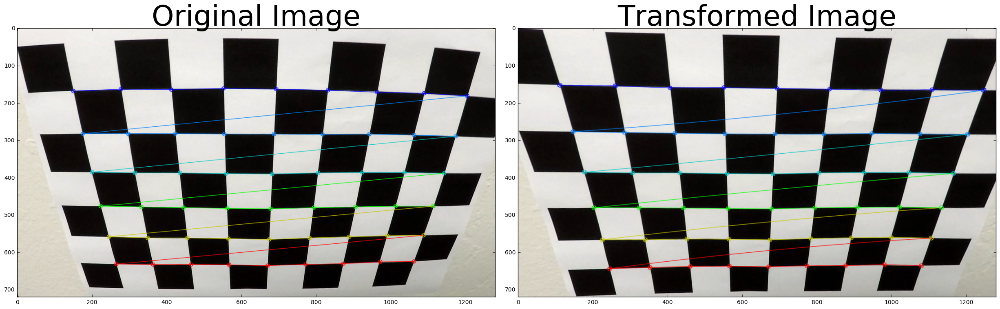

In [7]:
# test on sample image
undist = cv2.undistort(sample_img, mtx, dist, None, mtx)
compare_images(sample_img, undist)

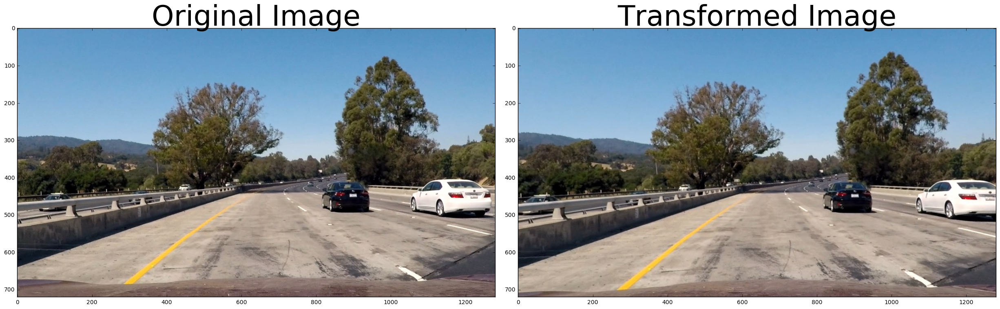

In [8]:
test_img = mpimg.imread('test_images/test1.jpg')
undist_img = cv2.undistort(test_img, mtx, dist, None, mtx)
compare_images(test_img, undist_img)

The differences are subtle to the naked eye, but upon closer inspection you can see the undistortion effect, specially on the lane lines

### Goal 3: Use color transforms, gradients and other techniques to create a thresholded binary image

I will start with the simplest technique, selecting a region of interest

In [295]:
def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

def select_region(image):
    """ 'Crop' the image to a 4-vertices polygonal image where the lane will most likely be situated """
        
    # define shape
    h, w = image.shape[:2]
    vertices = np.array([[(50, h),
                          (int(w/2)-100, 415), 
                          (int(w/2)+100, 415), 
                          (w-50,h)]], 
                        dtype=np.int32)
    
    # apply mask
    image = region_of_interest(image, vertices)

    return image


Moving to color threshold

In [276]:
def color_thresh(img, thresh=(90,255)):
    # isolate s channel from HLS
    s_img = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)[:, :, 2]

    # apply color threshold
    hls_binary = np.zeros_like(s_img)
    hls_binary[(s_img >= thresh[0]) & (s_img <= thresh[1])] = 1
    
    return hls_binary

Apply gradient threshold, with both gradient magnitude (combined or by axis) and direction thresholds

In [277]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0,255)):
    # calculate directional gradient
    if orient=='x':
        sobel = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    else:
        sobel = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # get absolute value
    abs_sobel = np.absolute(sobel)
    # scale it
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))    
    # create binary mask and apply threshold
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel>=thresh[0]) & (scaled_sobel<=thresh[1])] = 1    

    return grad_binary

def mag_thresh(img, sobel_kernel=3, thresh=(0,255)):
    # calculate gradient magnitude
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    grad_mag = np.sqrt(sobelx**2 + sobely**2)
    # scale it
    scaled_sobel = np.uint8(255*grad_mag/np.max(grad_mag))    
    # create binary mask and apply threshold
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel>=thresh[0]) & (scaled_sobel<=thresh[1])] = 1    

    return grad_binary

def dir_thresh(img, sobel_kernel=3, thresh=(0,np.pi/2)):
    # calculate sobel
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # calculate gradient direction
    grad_dir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    # create binary mask and apply threshold
    grad_binary = np.zeros_like(grad_dir)
    grad_binary[(grad_dir>=thresh[0]) & (grad_dir<=thresh[1])] = 1
    
    return grad_binary


Let's visualize the effect of each transform and try to find an optimal point

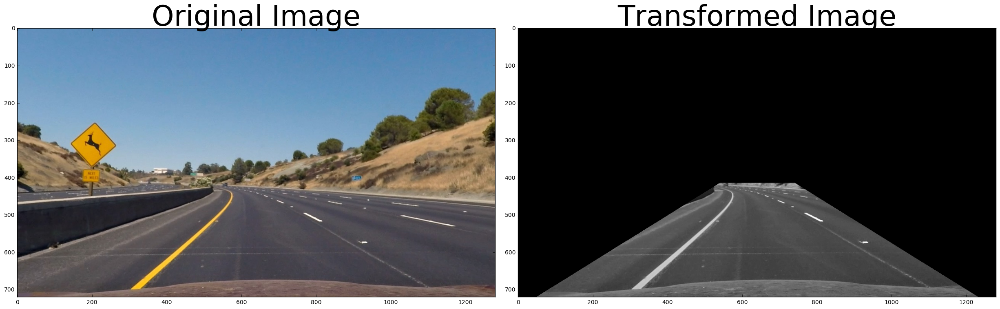

In [348]:
cropped_img = select_region(cv2.cvtColor(undist_img, cv2.COLOR_RGB2GRAY))
compare_images(undist_img, cropped_img, cmap='gray')

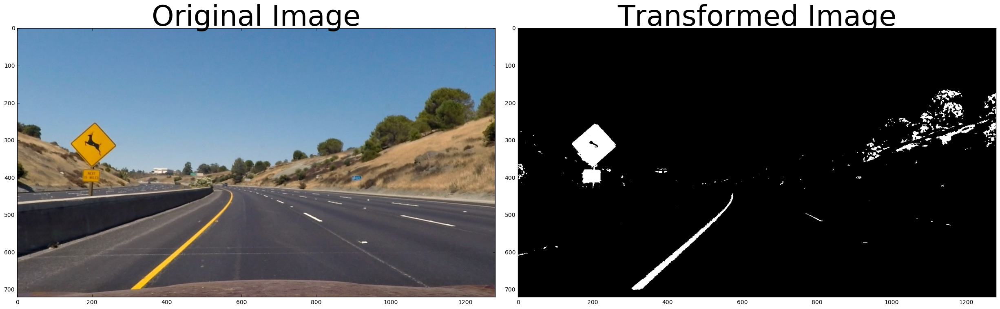

In [367]:
color_binary = color_thresh(undist_img, thresh=(120,255))
compare_images(undist_img, color_binary, cmap='gray')

In [365]:
# gray = cv2.cvtColor(undist_img, cv2.COLOR_RGB2HLS)[:, :, 2]
gray = cv2.cvtColor(undist_img, cv2.COLOR_RGB2GRAY)

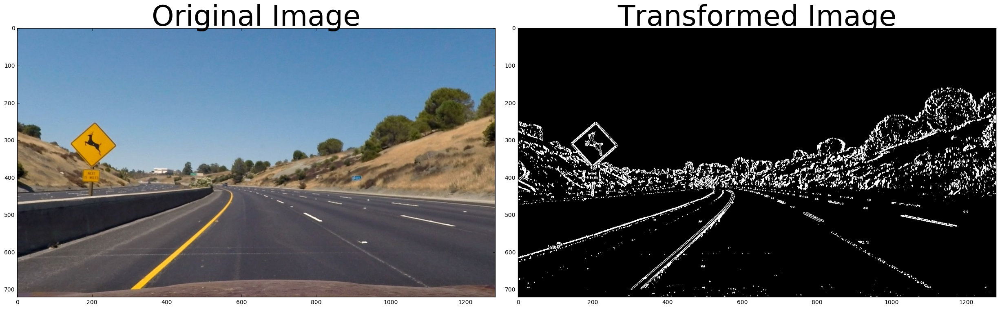

In [366]:
gradx_binary = abs_sobel_thresh(gray, orient='x', sobel_kernel=5, thresh=(20,100))
compare_images(undist_img, gradx_binary, cmap='gray')

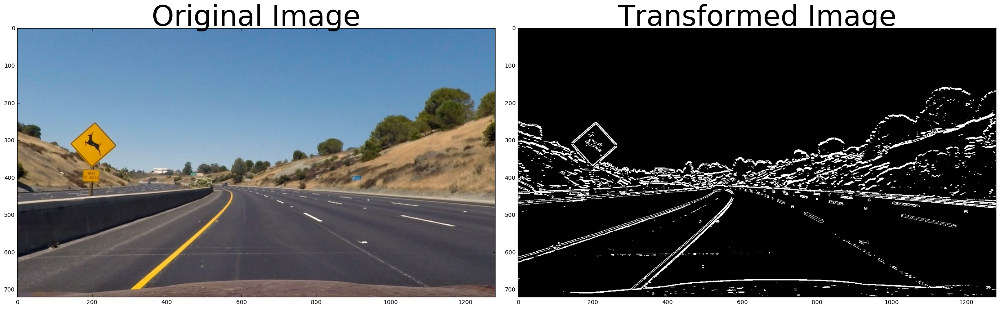

In [368]:
grady_binary = abs_sobel_thresh(gray, orient='y', sobel_kernel=7, thresh=(30,100))
compare_images(undist_img, grady_binary, cmap='gray')

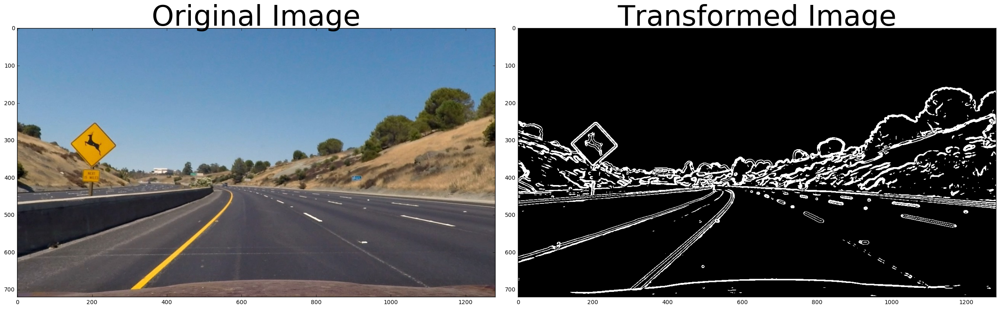

In [369]:
mag_binary = mag_thresh(gray, sobel_kernel=15, thresh=(40,120))
compare_images(undist_img, mag_binary, cmap='gray')

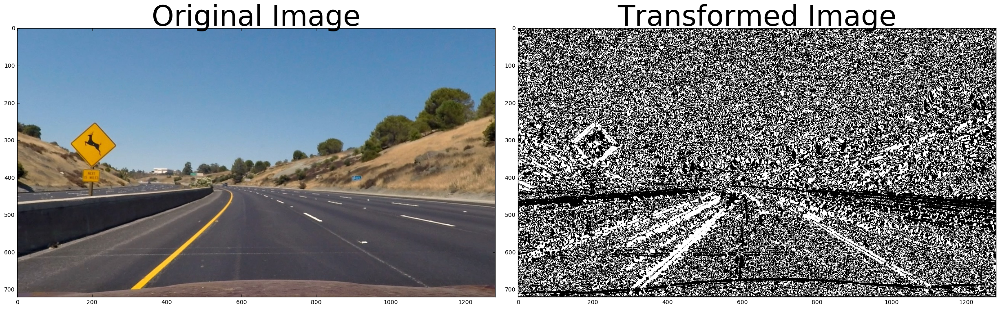

In [370]:
dir_binary = dir_thresh(gray, sobel_kernel=15, thresh=(0.70,1.3))
compare_images(undist_img, dir_binary, cmap='gray')

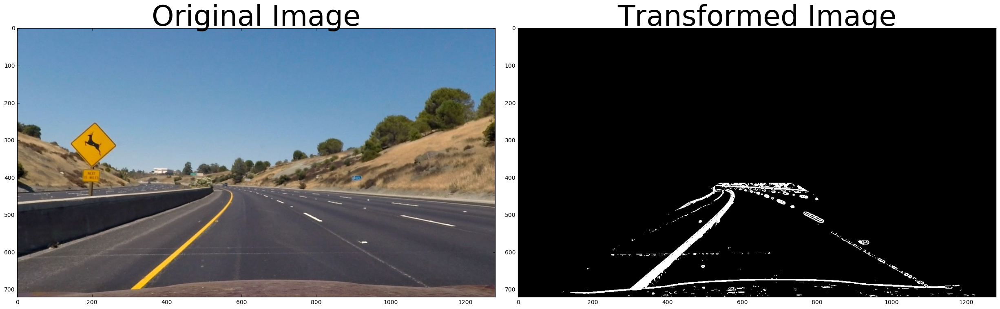

In [371]:
combined = np.zeros_like(gray)

combined[((gradx_binary == 1) | (grady_binary == 1) | (mag_binary == 1) | (color_binary==1)) & (cropped_img!=0) ] = 1 
compare_images(undist_img, combined, cmap='gray')

### Goal 4: Apply a perspective tranform to rectify binary image ("birds-eye view")

I will first test it on the undistorted chessboard image sample, before moving to the lane lines image

In [324]:
# Convert to gray and find corners
n = 3
sample_img = mpimg.imread('camera_cal/calibration{}.jpg'.format(n))
undist_sample_img = cv2.undistort(sample_img, mtx, dist, None, mtx)
gray = cv2.cvtColor(undist_sample_img, cv2.COLOR_RGB2GRAY)
ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)

In [325]:
# define src to be the most distant corners forming a rectange
# src = corners[[0,nx,len(corners)-1-nx,len(corners)-1], 0]
src = corners[[0,nx-1,-1,-nx], 0]
src

array([[  191.49125671,    60.40036774],
       [ 1037.84411621,    71.5462265 ],
       [ 1147.37756348,   567.421875  ],
       [   93.57233429,   580.75256348]], dtype=float32)

In [326]:
# create dst
offset = 100
h,w = gray.shape
dst = np.array([[offset,offset],[w-offset,offset],
                [w-offset, h-offset],[offset, h-offset]], 
               dtype=np.float32)
dst

array([[  100.,   100.],
       [ 1180.,   100.],
       [ 1180.,   620.],
       [  100.,   620.]], dtype=float32)

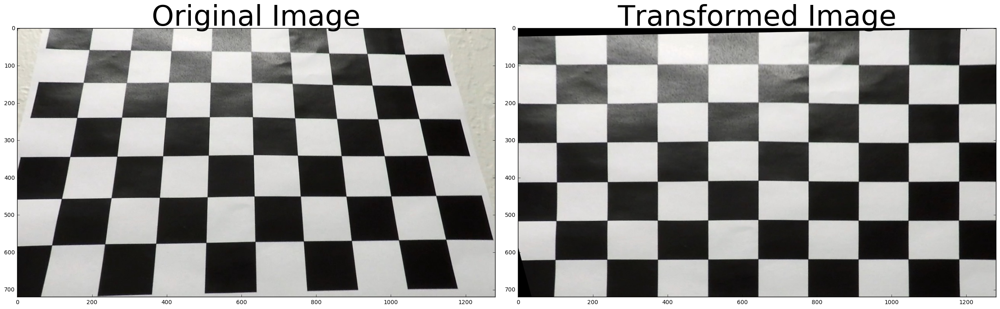

In [327]:
M = cv2.getPerspectiveTransform(src,dst)
warped_img = cv2.warpPerspective(undist_sample_img, M, gray.shape[::-1], 
                                flags=cv2.INTER_LINEAR)
compare_images(undist_sample_img, warped_img)

Next I will try perspective transform on a lane road. For now I will manually detect 4 points in the road, as indicated in the lessons, and figure it out later how do it in video stream automatically.

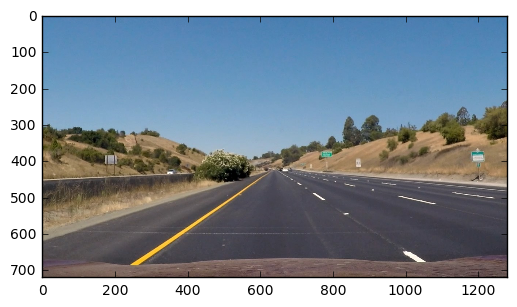

In [328]:
straight_img = mpimg.imread('test_images/straight_lines1.jpg')
plt.imshow(straight_img)

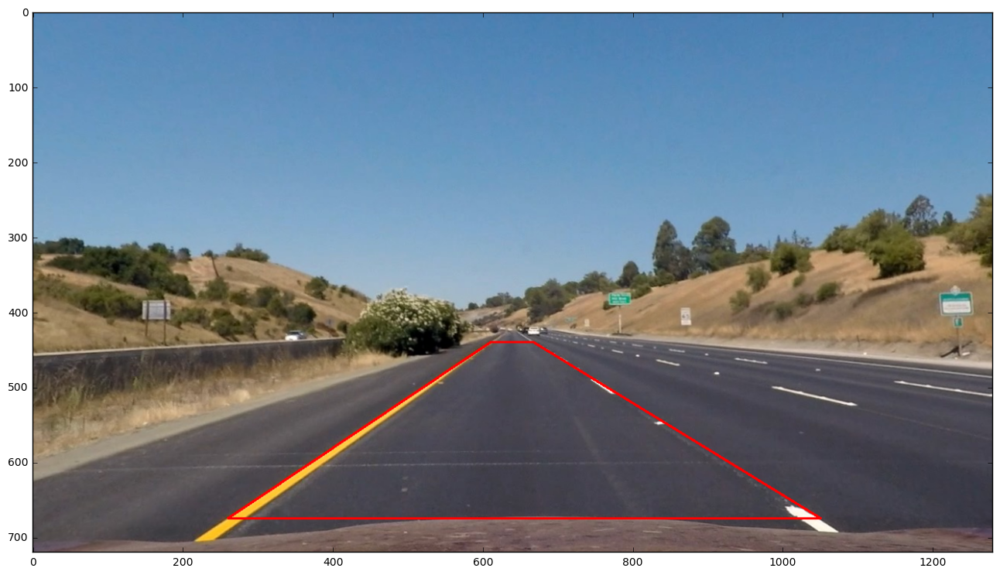

In [398]:
#undistort image
undist_img = cv2.undistort(straight_img, mtx, dist, None, mtx)
# set source
#src = np.array([[611, 440],[667, 440],[1044,675],[260,675]], dtype=np.float32)
# src = np.array([[594, 450],[686, 450],[1085,700],[220,700]], dtype=np.float32)
src = np.array([[610, 440],[667, 440],[1050,675],[260,675]], dtype=np.float32)
# set destination
offset = 300
h,w = undist_img.shape[:2]
dst = np.array([[offset,0],[w-offset,0],
                [w-offset, h],[offset, h]], 
               dtype=np.float32)
# warp image
M = cv2.getPerspectiveTransform(src,dst)
warped_img = cv2.warpPerspective(undist_img, M, (w,h), 
                                flags=cv2.INTER_LINEAR)

draw_undist_img = np.copy(undist_img)
draw_warped_img = np.copy(warped_img)

cv2.polylines(draw_undist_img,np.int_([src]),True,color=(255,0,0), thickness=2)
cv2.polylines(draw_warped_img,np.int_([dst]),True,color=(255,0,0), thickness=3)

# plot
#plt.figure(figsize=(18,9))
#plt.imshow(draw_undist_img)
compare_images(draw_undist_img, draw_warped_img)

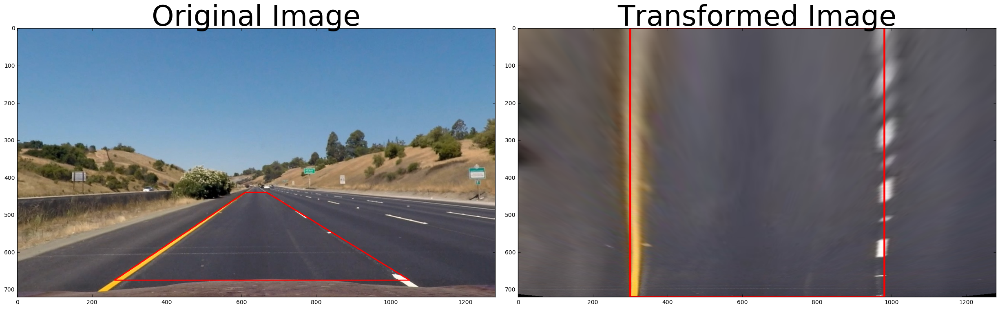

In [400]:
compare_images(draw_undist_img, draw_warped_img)

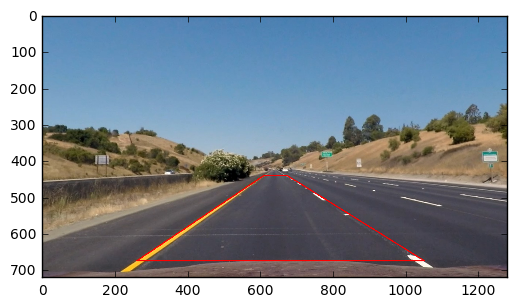

In [397]:
plt.imshow(draw_undist_img)

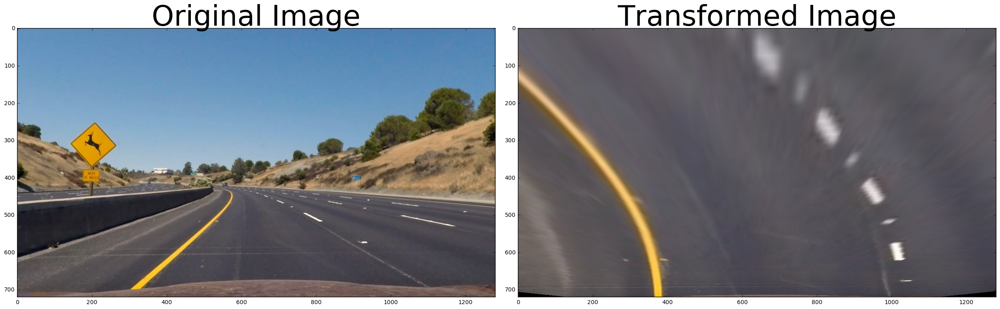

In [372]:
# testing it in a curved image
curved_img = mpimg.imread('test_images/test2.jpg')
undist_img = cv2.undistort(curved_img, mtx, dist, None, mtx)

# warp image
M = cv2.getPerspectiveTransform(src,dst)
warped_img = cv2.warpPerspective(undist_img, M, (w,h), 
                                flags=cv2.INTER_LINEAR)
# plot
compare_images(undist_img, warped_img)

### Goal 5: Detect lane pixels and fit to find the lane boundary.

In [373]:
def preprocess(img):
    gray = cv2.cvtColor(undist_img, cv2.COLOR_RGB2GRAY)

    #gradient
    cropped_img = select_region(gray)
    color_binary = color_thresh(undist_img, thresh=(120,255))
    gradx_binary = abs_sobel_thresh(gray, orient='x', sobel_kernel=5, thresh=(20,100))
    grady_binary = abs_sobel_thresh(gray, orient='y', sobel_kernel=7, thresh=(30,100))  
    mag_binary = mag_thresh(gray, sobel_kernel=15, thresh=(40,120))
    dir_binary = dir_thresh(gray, sobel_kernel=15, thresh=(0.70,1.3))

    combined = np.zeros_like(gray)
    combined[((gradx_binary == 1) | (grady_binary == 1) | (mag_binary == 1) | (color_binary==1)) & (cropped_img!=0) ] = 1 
    return combined

combined = preprocess(undist_img)
combined = cv2.warpPerspective(combined, M, (w,h), flags=cv2.INTER_LINEAR)


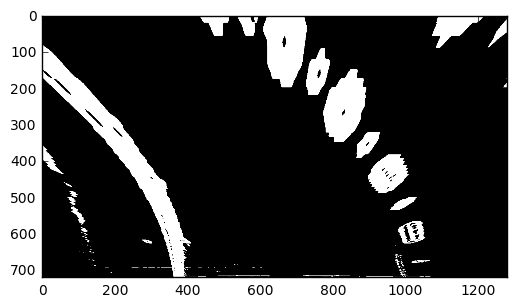

In [385]:
plt.imshow(combined, cmap='gray')

The overall idea is to split the image into thin slices, and verify the center of each lane by using the histogram peak for each slice. Let's first visualize this strategy to have an idea how it will work

I will try the same process, using Udacity's code for estimating the sliding windows

In [382]:

# Take a histogram of the bottom half of the image
histogram = np.sum(combined[combined.shape[0]/2:,:], axis=0)
# Create an output image to draw on and  visualize the result
out_img = np.dstack((combined, combined, combined))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]/2)
#leftx_base = np.argmax(histogram[:midpoint])
#rightx_base = np.argmax(histogram[midpoint:]) + midpoint
leftx_base = np.argmax(histogram[200:500]) + 200
rightx_base = np.argmax(histogram[800:1100]) + 800

# Choose the number of sliding windows
nwindows = 18
# Set height of windows
window_height = np.int(combined.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = combined.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = combined.shape[0] - (window+1)*window_height
    win_y_high = combined.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

(720, 0)

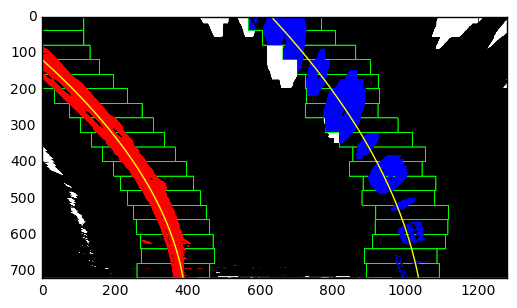

In [383]:
# Generate x and y values for plotting
ploty = np.linspace(0, combined.shape[0]-1, combined.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)


Assuming you already have the points, there is no need estimate sliding window again

In [376]:
# Assume you now have a new warped binary image 
# from the next frame of video (also called "binary_warped")
# It's now much easier to find line pixels!
nonzero = combined.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
margin = 100
left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

# Again, extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds]
# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)
# Generate x and y values for plotting
ploty = np.linspace(0, combined.shape[0]-1, combined.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

(720, 0)

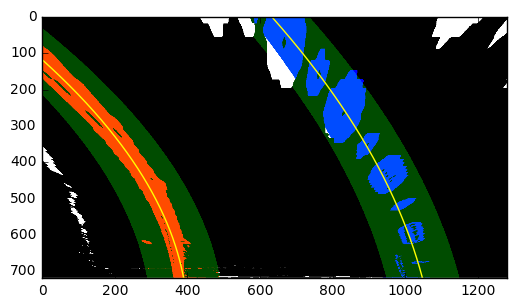

In [377]:
# Create an image to draw on and an image to show the selection window
out_img = np.dstack((combined, combined, combined))*255
window_img = np.zeros_like(out_img)
# Color in left and right line pixels
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

# Generate a polygon to illustrate the search window area
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))

# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

### Goal 6: Determine the curvature of the lane and vehicle position with respect to center

First calculate the radius of curvature in pixel space

In [217]:
# Define y-value where we want radius of curvature
# I'll choose the maximum y-value, corresponding to the bottom of the image
y_eval = np.max(fity)
left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
print(left_curverad, right_curverad)
# Example values: 1926.74 1908.48

1245.74832296 927.969389983


Then calculate radius of curvature in real world space, based on the lane dimensions given in the instructions (30 meters long and 3.7 meters wide)

In [218]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(fity*ym_per_pix, fit_leftx*xm_per_pix, 2)
right_fit_cr = np.polyfit(fity*ym_per_pix, fit_rightx*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')
# Example values: 632.1 m    626.2 m

418.699143535 m 166.790756627 m


### Goal 7: Warp the detected lane boundaries back onto the original image.

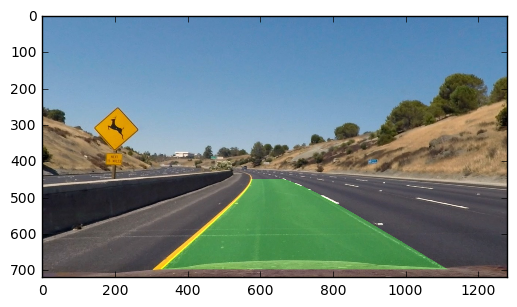

In [220]:
# Create an image to draw the lines on
warp_zero = np.zeros_like(combined).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
Minv = np.linalg.inv(M)
newwarp = cv2.warpPerspective(color_warp, Minv, (curved_img.shape[1], curved_img.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(undist_img, 1, newwarp, 0.3, 0)
plt.imshow(result)

### Goal 8: Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

In [ ]:
# I will r